In [ ]:
import os
import time
import pickle
import warnings
import pandas as pd
import networkx as nx
import matplotlib.pyplot as plt

import numpy as np
from numpy import linalg as LA
from numpy import histogram2d

from scipy import signal
from scipy.fft import fft, fftfreq, fftshift
from scipy.signal import find_peaks, butter, filtfilt, welch
from scipy.ndimage import gaussian_filter
from scipy.io import wavfile

import plotly.express as px
import plotly.graph_objects as go
from plotly.subplots import make_subplots

from sklearn.ensemble import RandomForestClassifier
from sklearn.svm import SVC
from sklearn.model_selection import train_test_split
from sklearn.metrics import classification_report, confusion_matrix

import utils as ut
from utils import try_except_decorator
%load_ext autoreload
%autoreload 2

# do not show warnings
warnings.filterwarnings("ignore")

The autoreload extension is already loaded. To reload it, use:
  %reload_ext autoreload


## Formulation

### Plan A - DETECTION

### Plan B - CLASSIFICATION

---

## Data Exploration

In [82]:
# upload files and process data into slices and time annotations

##############################
# dpv1 - Croatia
##############################

data_file = "../data/scooter_example_1.wav"
fs, data = wavfile.read(data_file)

# crop data
start_time = 60 # seconds
end_time = 160 # seconds
data = data[int(start_time*fs):int(end_time*fs)]

# set time annotations
# 1st detection: 3-37 seconds
d1_start = 3
d1_end = 37
# 2nd detection: 91-143 seconds
d2_start = 91
d2_end = 143
# need to account for time cropping
dpv1_time_annotations = np.zeros_like(data, dtype=int)
if d1_end > start_time and d1_start < end_time:
    s = max(d1_start, start_time) - start_time
    e = min(d1_end, end_time) - start_time
    dpv1_time_annotations[int(s*fs):int(e*fs)] = 1
if d2_end > start_time and d2_start < end_time:
    s = max(d2_start, start_time) - start_time
    e = min(d2_end, end_time) - start_time
    dpv1_time_annotations[int(s*fs):int(e*fs)] = 1

dpv1_slice = data[int(35*fs):int(40*fs)]


##############################
# dpv2 - Haifa
##############################

data_file = "../data/RBW6922_20250612_060900_copy.wav"
fs, data = wavfile.read(data_file)

# crop data
start_time = 0 # seconds
end_time = 120 # seconds
data = data[int(start_time*fs):int(end_time*fs)]

dpv2_slice = data[int(15*fs):int(20*fs)]


##############################
# Ship
##############################

data_file = "../data/croatia/2507_1_1000m/RBW6737_20250725_083900.wav"
fs, data = wavfile.read(data_file)

lsnr_slice = data[int(40*fs):int(45*fs)]


##############################
# Ship
##############################

data_file = "../data/ships/Yacht_02.08.23_111540_20secCPA.wav"
fs, data = wavfile.read(data_file)
ship_time_annotations = np.ones_like(data, dtype=int)

ship_slice = data[int(5*fs):int(15*fs)]


##############################
# Background Noise - Croatia
##############################
data_file = "../data/croatia/2507_1_1000m/RBW6737_20250725_080600.wav"
fs, data = wavfile.read(data_file)
bg_noise_time_annotations = np.ones_like(data, dtype=int)

bg_slice = data[int(5*fs):int(15*fs)]


slices = {
    "dpv1": dpv1_slice,
    "dpv2": dpv2_slice,
    "low_snr_dpv1": lsnr_slice,
    "ship": ship_slice,
    "bg": bg_slice}

In [83]:
# show waveforms, pwelch and normalized pwelch for each slice

# welch params
welch_nperseg = 16384  # in samples
remove_dc = 20
crop_freq = None  # in Hz, set to None to disable
normalization_win = 101  # in samples, should be odd


fig = make_subplots(rows=5, cols=3, subplot_titles=
                    ["dpv1 Waveform", "dpv1 Pwelch", "dpv1 Normalized Pwelch",
                     "dpv2 Waveform", "dpv2 Pwelch", "dpv2 Normalized Pwelch",
                     "Low SNR dpv1 Waveform", "Low SNR dpv1 Pwelch", "Low SNR dpv1 Normalized Pwelch",
                     "Ship Waveform", "Ship Pwelch", "Ship Normalized Pwelch",
                     "Background Noise Waveform", "Background Noise Pwelch", "Background Noise Normalized Pwelch"
                     ])
for i, (title, slice_data) in enumerate(slices.items()):
    fig.add_trace(go.Scatter(y=slice_data, mode='lines'), row=i+1, col=1)
    f, Pxx = ut.pwelch(slice_data, fs=fs, nperseg=welch_nperseg, remove_dc=remove_dc, crop_freq=crop_freq, normalization_window_size=None)
    fig.add_trace(go.Scatter(x=f, y=Pxx, mode='lines'), row=i+1, col=2)
    f_norm, Pxx_norm = ut.pwelch(slice_data, fs=fs, nperseg=welch_nperseg, remove_dc=remove_dc, crop_freq=crop_freq, normalization_window_size=normalization_win)
    fig.add_trace(go.Scatter(x=f_norm, y=Pxx_norm, mode='lines'), row=i+1, col=3)
fig.update_layout(height=800, width=1200, title_text="Audio Slices")
fig.show()

In [85]:
# normalized-pwelch tonal line detection

# more params (using welch params from above)
spec_nperseg = 8192  # in samples
threshold = 5

fig = make_subplots(rows=len(slices), cols=2)
for i, (title, slice_data) in enumerate(slices.items()):
    # spectrogram
    f_spec, t, Sxx = ut.get_spectrogram(slice_data, fs=fs, nperseg=spec_nperseg)
    fig.add_trace(go.Heatmap(z=Sxx, x=t, y=f_spec, colorscale='Viridis', showscale=False), row=i+1, col=1)
    fig.update_yaxes(title_text='Frequency (Hz)', row=i+1, col=1)
    fig.update_xaxes(title_text='Time (s)', row=i+1, col=1)

    # pwelch line detection
    detected_frequencies, detected_powers, f_welch, Pxx = ut.pwelch_line_detection(slice_data, fs=fs, nperseg=welch_nperseg, remove_dc=remove_dc, crop_freq=crop_freq, normalization_window_size=normalization_win, threshold=threshold)
    fig.add_trace(go.Scatter(x=f_welch, y=Pxx, mode='lines', line=dict(color='blue'), showlegend=False), row=i+1, col=2)
    fig.update_layout(title=f'{title} - Power Spectral Density with Detections', xaxis_title='Frequency (Hz)', yaxis_title='Power/Frequency (dB/Hz)')

    # overlay detections on spectrogram
    for freq in detected_frequencies:
        fig.add_trace(go.Scatter(x=t, y=[freq]*len(t), mode='lines', line=dict(color='red', width=1), showlegend=False), row=i+1, col=1)
        fig.add_trace(go.Scatter(x=[freq], y=[detected_powers[np.where(detected_frequencies==freq)[0][0]]], mode='markers', marker=dict(color='red', size=8), showlegend=False), row=i+1, col=2)

fig.update_layout(height=800, width=1200, title_text="Audio Slices")
fig.show()

---

## Mutual Information Graph (between welch-detected peaks)

In [92]:
# calculate mutual information adjacency matrix between welch-detected frequencies

threshold = 5  # in std deviations above mean

for i, (title, slice_data) in enumerate(slices.items()):
    print("=============================")
    print(f"\nProcessing: {title}")

    detected_frequencies, detected_powers, f_welch, Pxx = ut.pwelch_line_detection(slice_data, fs=fs, nperseg=welch_nperseg, remove_dc=remove_dc, crop_freq=crop_freq, normalization_window_size=normalization_win, threshold=threshold)
    f_spec, t, Sxx = ut.get_spectrogram(slice_data, fs=fs, nperseg=spec_nperseg)

    # find Sxx indices of detected frequencies
    detected_indices = []
    for freq in detected_frequencies:
        idx = (np.abs(f_spec - freq)).argmin()
        detected_indices.append(idx)

    detected_Sxx = Sxx[detected_indices, :]

    # compute mutual information matrix
    mi_threshold = None  # set to None to disable thresholding, otherwise set to percentile value (e.g., 75)
    mi_adj = ut.compute_mi_adjacency_matrix(detected_Sxx, percentile_threshold=mi_threshold)

    # fig = go.Figure(data=go.Heatmap(z=mi_adj, x=detected_frequencies, y=detected_frequencies, colorscale='Viridis'))
    # fig.update_layout(title='Mutual Information Adjacency Matrix', xaxis_title='Detected Frequencies', yaxis_title='Detected Frequencies', height=600, width=600)
    # fig.show()

    # print mi_adj as table
    mi_df = pd.DataFrame(mi_adj, index=[f"{freq:.1f} Hz" for freq in detected_frequencies], columns=[f"{freq:.1f} Hz" for freq in detected_frequencies])
    print("Mutual Information Adjacency Matrix:")
    print(mi_df)


Processing: dpv1
Mutual Information Adjacency Matrix:
           640.6 Hz  1281.2 Hz
640.6 Hz   0.000000   0.089864
1281.2 Hz  0.089864   0.000000

Processing: dpv2
Mutual Information Adjacency Matrix:
             23.4 Hz  2312.5 Hz  2359.4 Hz  15679.7 Hz  16312.5 Hz  \
23.4 Hz     0.000000   0.053328   0.064110    0.069282    0.083669   
2312.5 Hz   0.053328   0.000000   0.065238    0.090030    0.042840   
2359.4 Hz   0.064110   0.065238   0.000000    0.084694    0.067473   
15679.7 Hz  0.069282   0.090030   0.084694    0.000000    0.034133   
16312.5 Hz  0.083669   0.042840   0.067473    0.034133    0.000000   
31781.2 Hz  0.050884   0.062186   0.060763    0.042732    0.059986   
31992.2 Hz  0.047302   0.060341   0.079244    0.035321    0.073217   
32203.1 Hz  0.028042   0.054374   0.065634    0.065402    0.040101   
47882.8 Hz  0.033750   0.043429   0.046513    0.021539    0.042889   
48093.8 Hz  0.037812   0.076120   0.039392    0.025947    0.074942   
48304.7 Hz  0.105462   0.02

In [65]:
# # as graph
# G = nx.from_numpy_array(mi_adj)

# ## create node and edge traces for plotly visualization
# edge_x = []
# edge_y = []
# for edge in G.edges():
#     x0, y0 = G.nodes[edge[0]]['pos']
#     x1, y1 = G.nodes[edge[1]]['pos']
#     edge_x.append(x0)
#     edge_x.append(x1)
#     edge_x.append(None)
#     edge_y.append(y0)
#     edge_y.append(y1)
#     edge_y.append(None)

# edge_trace = go.Scatter(
#     x=edge_x, y=edge_y,
#     line=dict(width=0.5, color='#888'),
#     hoverinfo='none',
#     mode='lines')

# node_x = []
# node_y = []
# for node in G.nodes():
#     x, y = G.nodes[node]['pos']
#     node_x.append(x)
#     node_y.append(y)

# node_trace = go.Scatter(
#     x=node_x, y=node_y,
#     mode='markers',
#     hoverinfo='text',
#     marker=dict(
#         showscale=True,
#         # colorscale options
#         #'Greys' | 'YlGnBu' | 'Greens' | 'YlOrRd' | 'Bluered' | 'RdBu' |
#         #'Reds' | 'Blues' | 'Picnic' | 'Rainbow' | 'Portland' | 'Jet' |
#         #'Hot' | 'Blackbody' | 'Earth' | 'Electric' | 'Viridis' |
#         colorscale='YlGnBu',
#         reversescale=True,
#         color=[],
#         size=10,
#         colorbar=dict(
#             thickness=15,
#             title=dict(
#               text='Node Connections',
#               side='right'
#             ),
#             xanchor='left',
#         ),
#         line_width=2))

# ## color node points
# node_adjacencies = []
# node_text = []
# for node, adjacencies in enumerate(G.adjacency()):
#     node_adjacencies.append(len(adjacencies[1]))
#     node_text.append('# of connections: '+str(len(adjacencies[1])))

# node_trace.marker.color = node_adjacencies
# node_trace.text = node_text

# ## create network graph figure
# fig = go.Figure(data=[edge_trace, node_trace],
#              layout=go.Layout(
#                 title=dict(
#                     text="<br>Network graph made with Python",
#                     font=dict(
#                         size=16
#                     )
#                 ),
#                 showlegend=False,
#                 hovermode='closest',
#                 margin=dict(b=20,l=5,r=5,t=40),
#                 annotations=[ dict(
#                     text="Python code: <a href='https://plotly.com/python/network-graphs/'> https://plotly.com/python/network-graphs/</a>",
#                     showarrow=False,
#                     xref="paper", yref="paper",
#                     x=0.005, y=-0.002 ) ],
#                 xaxis=dict(showgrid=False, zeroline=False, showticklabels=False),
#                 yaxis=dict(showgrid=False, zeroline=False, showticklabels=False))
#                 )
# fig.show()



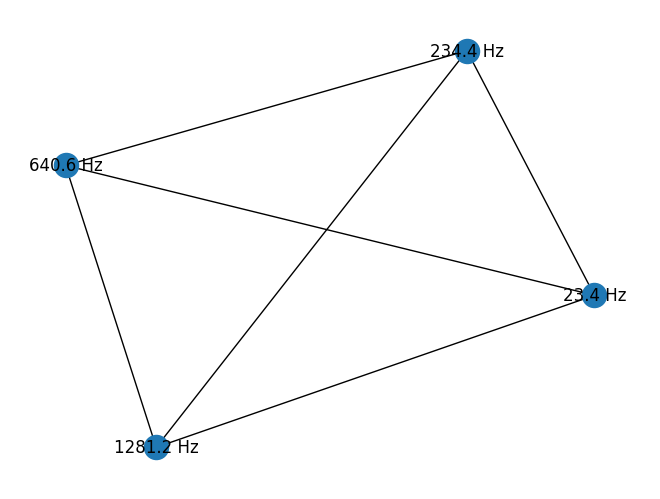

In [66]:
# as graph
G = nx.from_numpy_array(mi_adj)
mapping = {i: f"{detected_frequencies[i]:.1f} Hz" for i in range(len(detected_frequencies))}
G = nx.relabel_nodes(G, mapping)

nx.draw(G, with_labels=True)
plt.show()

---

## Visibility Graph

In [89]:
# visibility graph for low SNR slice vs BG noise slice

lsnr_f_welch, lsnr_Pxx = ut.pwelch(lsnr_slice, fs=fs, nperseg=16384, remove_dc=20, crop_freq=None, normalization_window_size=None)
lsnr_vis_counts = ut.get_vis_counts(f=lsnr_f_welch, Pxx=lsnr_Pxx)


fig = make_subplots(rows=5, cols=3, subplot_titles=
                    ["dpv1", "dpv1 Visibility Graph Degree", "dpv1 Visibility Graph Degree (No Norm)",
                     "dpv2", "dpv2 Visibility Graph Degree", "dpv2 Visibility Graph Degree (No Norm)",
                     "Low SNR dpv1", "Low SNR dpv1 Visibility Graph Degree", "Low SNR dpv1 Visibility Graph Degree (No Norm)",
                     "Ship", "Ship Visibility Graph Degree", "Ship Visibility Graph Degree (No Norm)",
                     "Background Noise", "Background Noise Visibility Graph Degree", "Background Noise Visibility Graph Degree (No Norm)"])
for i, (title, slice_data) in enumerate(slices.items()):
    f_norm, Pxx_norm = ut.pwelch(slice_data, fs=fs, nperseg=welch_nperseg, remove_dc=remove_dc, crop_freq=crop_freq, normalization_window_size=normalization_win)
    fig.add_trace(go.Scatter(x=f_norm, y=Pxx_norm, mode='lines'), row=i+1, col=1)
    vis_counts = ut.get_vis_counts(f=f_norm, Pxx=Pxx_norm)
    fig.add_trace(go.Scatter(x=f_norm, y=vis_counts, mode='lines'), row=i+1, col=2)
    f, Pxx = ut.pwelch(slice_data, fs=fs, nperseg=welch_nperseg, remove_dc=remove_dc, crop_freq=crop_freq, normalization_window_size=None)
    vis_counts = ut.get_vis_counts(f=f, Pxx=Pxx)
    fig.add_trace(go.Scatter(x=f, y=vis_counts, mode='lines'), row=i+1, col=3)
fig.update_layout(height=800, width=1200, title_text="visibility graphs degree of Audio Slices")
fig.show()